In [2]:
import pandas as pd

data = pd.read_csv("../data/processed/test-dataset.csv")

In [3]:
data

,COL_NM,DATA_TP_NM,PK_YN,NULL_PERM_YN,DATA_MAX_LEN,DATA_MIN_LEN,VAR_LEN_YN,DT_RT,NUM_ONLY_YN,NUM_DOM_RT,...,EMAIL_RT,GROUP_DATA_RT,INC_KOR_YN,INC_SPACE_YN,FLOAT_CNT,INT_CNT,MINUS_CNT,PLUS_CNT,URL_RT,DOM_NM
0,ATTR_COL_NM,VARCHAR2,N,Y,5,5,N,0.0,N,0.0,...,0.0,0.00,N,N,0,0,0,0,0.0,명
1,ATTR_KOR_COL_NM,VARCHAR2,N,Y,8,8,N,0.0,N,0.0,...,0.0,0.00,N,N,0,0,0,0,0.0,명
2,DATA_DCML_LEN_COL_NM,VARCHAR2,N,Y,10,10,N,0.0,N,0.0,...,0.0,0.00,N,N,0,0,0,0,0.0,명
3,DATA_LEN_COL_NM,VARCHAR2,N,Y,6,6,N,0.0,N,0.0,...,0.0,0.00,N,N,0,0,0,0,0.0,명
4,DATA_TP_COL_NM,VARCHAR2,N,Y,7,7,N,0.0,N,0.0,...,0.0,0.00,N,N,0,0,0,0,0.0,명
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3831,REQ_TP_CD,VARCHAR2,N,Y,2,2,N,0.0,N,100.0,...,0.0,100.00,N,N,0,0,0,0,0.0,코드
3832,STD_ID,VARCHAR2,N,Y,12,11,Y,0.0,N,0.0,...,0.0,99.67,N,N,0,0,0,0,0.0,번호
3833,TBL_ID,VARCHAR2,N,Y,19,12,Y,0.0,N,0.0,...,0.0,66.66,N,N,0,0,0,0,0.0,번호
3834,TBL_SYS_ID,VARCHAR2,N,Y,12,12,N,0.0,N,0.0,...,0.0,91.66,N,N,0,0,0,0,0.0,번호


In [4]:
data.columns

Index(['COL_NM', 'DATA_TP_NM', 'PK_YN', 'NULL_PERM_YN', 'DATA_MAX_LEN',
       'DATA_MIN_LEN', 'VAR_LEN_YN', 'DT_RT', 'NUM_ONLY_YN', 'NUM_DOM_RT',
       'PER_RT', 'EMAIL_RT', 'GROUP_DATA_RT', 'INC_KOR_YN', 'INC_SPACE_YN',
       'FLOAT_CNT', 'INT_CNT', 'MINUS_CNT', 'PLUS_CNT', 'URL_RT', 'DOM_NM'],
      dtype='object')

In [5]:
data.DOM_NM.value_counts()

DOM_NM
번호    1318
명     1213
날짜     621
코드     292
여부     287
수량      95
율       10
Name: count, dtype: int64

In [6]:
from ydata_profiling import ProfileReport, compare

In [7]:
profile = ProfileReport(data, title="Profiling Report")

In [8]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [9]:
# 3개 이상은 리포트 머지가 안됨.
reports = {}
for domain, df in data.groupby("DOM_NM"):
    reports[domain] = ProfileReport(df, title=domain)


In [10]:
data.query("DOM_NM == '명'").PK_YN.value_counts()

PK_YN
N    1088
Y     125
Name: count, dtype: int64

In [12]:
data.DOM_NM.value_counts()

DOM_NM
번호    1318
명     1213
날짜     621
코드     292
여부     287
수량      95
율       10
Name: count, dtype: int64

profile시 distinct rate, distinct 수, : 코드 여부 판별하는 변수. type이 문자열일때 length가 고정인지 여부. id  판별. 
추출할때 데이터가 깨끗하지 않은 것을 가정해야 함. 그래서 프로파일링 결과를 하나의 값으로 보는 것이 아니라 분포에 대한 정보로 봐야 함.

산업데이터의 경우, 사람의 개입이 아닌 센서고장이나 환경문제 등으로 야기되는 비정상 수치가 들어갈 수 있음. 도메인 범위 외의 값이 들어가는 비정상적인 경우에 기록되는 값은 정상적인 경우와 확실히 구분되는 형태의 값을 출력할 수 있음. 
이에 대한 것이 모델 내에서 필터링이 될 수 있도록 모델의 입력으로 전달되어야 판정할 수 있음.

패턴에 대한 비율

레이블을 어떻게 만들지... Label별로 변수에 대한 분포를 정해 넣고 만들어 넣어보자.

날짜: 날짜패턴비율, data_length_distinct_cnt, data_length_purity or 1- max(pi)
명: 컬럼명이 id, nm, val 등을 많이 포함하고 있음.(분포가 아님)
컬럼값에 대해서는 분포를 설정해야 하는데, 이에 대한 자료는 없다. 대략적으로 만들어야 한다.(메타데이터의 RT라는 정보를 이용하자)
data_len_distribution: data_len_distinct_cnt, length_impurity

'명'에 적합한 패턴에 일치하는 비율 (주소 패턴, ID 패턴, 장소 패턴, 사람이름 패턴, URL 패턴, 이메일 패턴). 컬럼명을 보고 판단하는 것이 좋음. 패턴에 대한 분포는 각각 이진분포임.
글자수에 대한 purity를 변수로 정해주면 의미있을 듯함. 이메일과 url 패턴은 보편적이니까 사용하면 되고, 장소, 주소 등은 사용여부 고민. 

코드는 값에 대한 distinct count, distinct rate, 글자수에 대한 purity

번호: 글자수에 대한 purity, 번호관련 rough한 패턴 생성해서 패턴통과 비율

여부: 패턴(Y/N, 1/0, True/False), value distinct count, value distinct rate

금액:??? 컬럼 데이터에 화폐 단위 포함여부.

수량:???

율: 숫자. 컬럼명을 보고 판단해야 할 듯. 범위에 대한 것은 소수점이 있느냐 없느냐 등 몇가지 패턴들을 만들어 놓아야 할 듯....

컬럼명 생성 룰 만들고

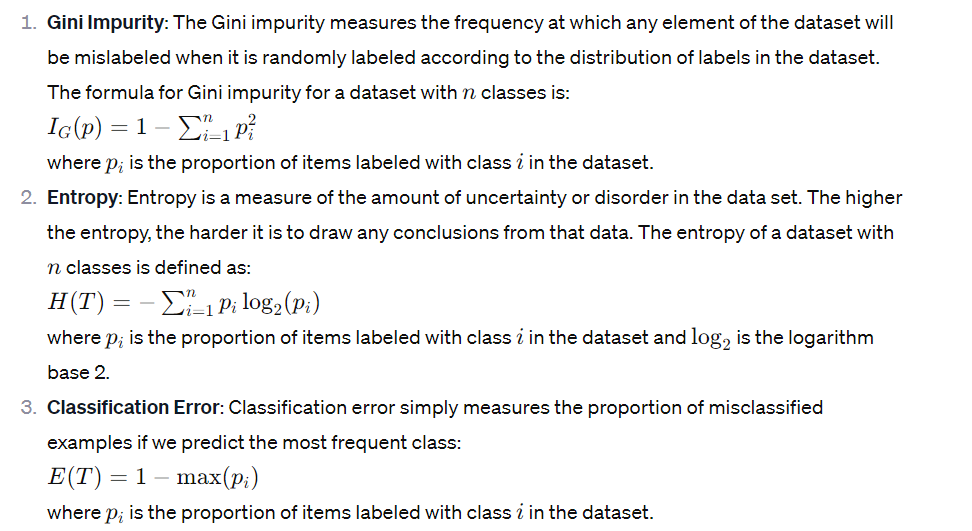


In [13]:
project의 모듈 단위를 어떤 기준으로 나눌까.
학습데이터 생성 부분.
- Feature 정의 부분(profiling factors): 탐색적 분석을 통해서 Feature정의(datatype 분포, pattern 분포, distinct 수, distinct 분포, distinct purity,): 
    패턴을 정할때 정교한 특정 패턴을 집어내는 것보다는 느슨한 여러개의 패턴을 결합해서 결과를 예측할 수 있도록 구성하자.
    번호 도메인: 숫자와 '-'로 구성되어있다. 패턴은 숫자로 되어있는지(문자가 포함되는 경우가 없다고 가정함.).   ^\d+(-\d+)*  : \d+  : [^0-9-]+ : '-' : lenght distinct purity
                문자 숫자 혼합 번호: 경기-23-32345-23 :문자와 숫자. 길이가 일정하다.문자는 한글,영문 모두 가능하다. 문자는 주로 앞에 있다. 
    금액 도메인: 숫자로 되어 있는 것 외에 달리 판단하기가 힘듬. (화폐 표기 여부가 들어가 있는지 여부정도가 있으나 실제 데이터에는 화폐단위가 안들어갈 듯함. 컬럼명으로 판단하는 것 정도.) 
    명 도메인: 주소명, 이메일 명, 건물명 등 문자타입이 많다. 한글, 숫자, 영문 및 허용된 특수기호 (@, 시, 도, 구, 동, 로, )
    수량 도메인: 0과 양의 정수
    분류 도메인: 1,0: Y,N: 
    날짜 도메인: (19|20)\d{2}, 01-12  날짜  일 \b(0?[1-9]|[12][0-9]|3[01])\b  월 \b(0?[1-9]|1[12])\b 시 \b(0?\d|1\d|2[0-3])\b   19는 년, 일에 해당 12는 월 일 시에 해당. 년월로 표기된 곳은 년, 월, 일 모두 통과됨.
                 번호도메인에 년,(월)까지 있고 나머지는 번호로 붙이는 경우가 있다. 숫자로만 되어있다. 이 경우는 
    
- 레이블 정의: 번호, 명, 코드, 날짜, 여부, 수량, 금액, 율
- 레이블별 학습데이터 생성: 
    메타데이터의 컬럼에 대해 Noise가 정규분포를 가정하고, Feature별로 분산 값을 정해서 Noisy data 생성, 컬럼명은 레이블에 맞게 작성하되 도메인명에 부합하는 것과 그렇지 않은 것을 베르눌리 분포 p를 정해서 생성하자.\
        Noise값 없는 경우의 메타데이터를 먼저 생성하고, 여기에 Noise를 섞인 데이터에 대한 메타데이터를 생성한다.
    실제 테이블의 컬럼 데이터를 생성해서 feature를 뽑아낸다.
- 

SyntaxError: invalid syntax (713770680.py, line 1)

In [ ]:
patterns = {}
keys, values를 만들자. 


In [ ]:
YYYY= r"(19|20)\d{2}"
MM= r"(0[1-9]|1[012])"
DD=r"(0[1-9]|[12][0-9]|3[01])"
TM = r"\s+([01][0-9]|2[0-4]):[0-5][0-9](:[0-5][0-9])?(\s+(PM|AM))?"
patterns = {
    'natural': r'^\d+$',
    'float': r'^[+-]?\d+[.]\d*$',
    'numberwith-': r'^\d+([-./:]\d+)*$',  #번호패턴 ddd-ddd-dddd-dd
    'numberwithchar': r'^([A-Za-z\uAC00-\uD7A3]+[-./:])?\d+([-./:]\d+)*$',  #문자번호 ww-dddd-ddd
    'datetime':  fr"^({YYYY}[-./]{MM}[-./]{DD}|{MM}[-./]{DD}[-./]{YYYY}|{DD}[-./]{YY}[-./]{YYYY})({TM})?$",
    "email": r"^[a-zA-Z0-9._%+-]+@[a-zA-Z0-9.-]+\.[a-zA-Z]{2,}$",
    "url":r"^(https?:\/\/)?([\da-z\.-]+)\.([a-z\.]{2,6})([\/\w \.-]*)*\/?$",
 }

In [36]:
import pandas as pd
import random
import string

def random_string(length):
    # 지정된 길이의 임의의 소문자 문자열을 생성
    return ''.join(random.choices(string.ascii_lowercase, k=length))

# 임의의 길이의 문자열로 구성된 Series 생성
random_series = pd.Series([random_string(random.randint(3, 5)) for _ in range(100)])
# print(random_series)

In [59]:
import pandas as pd
import random
import string

def generate_random_string_series(n, non_length_4_ratio=0):
    """
    Generates a pandas Series of random strings. 
    Allows adjusting the ratio of non-length-4 strings.

    Args:
    n (int): Number of strings in the series.
    non_length_4_ratio (float): Probability of generating a string that is not of length 4.

    Returns:
    pandas.Series: Series of random strings.
    """
    strings = []
    for _ in range(n):
        length = 4 if random.random() >= non_length_4_ratio else random.choice([3, 5, 6])
        random_string = ''.join(random.choices(string.ascii_letters, k=length))
        strings.append(random_string)
    
    return pd.Series(strings)

# Example usage
# Default behavior (all strings of length 4)
series_default = generate_random_string_series(100)
print(series_default.head())

# Adjusting the ratio to have 30% non-length-4 strings
series_custom_ratio = generate_random_string_series(100, non_length_4_ratio=0.3)
print(series_custom_ratio.head())



0     PhHk
1     zhlO
2    baJEr
3     vmfg
4     siRT
dtype: object


In [61]:
import pandas as pd
import random
import string
from functools import wraps

def adjust_ratio(func):
    """
    데코레이터: 문자열 길이에 대한 비율을 조정하는 기능을 제공한다.

    이 데코레이터는 데코레이트된 함수가 생성하는 문자열의 길이를 조정한다.
    기본 길이(4)와 다른 길이(3, 5, 6 중 하나) 사이의 비율을 조정할 수 있도록 한다.
    비율 조정은 `diff_length_ratio` 인자를 통해 결정된다.

    Args:
    func (callable): 데코레이트될 함수. 문자열 길이를 인자로 받는다.

    Returns:
    callable: 래퍼 함수. 문자열의 길이와 다른 길이 비율을 인자로 받는다.
    """
    @wraps(func)
    def wrapper(length,diff_length_ratio):
        len = length if random.random() >= diff_length_ratio else random.choice([3, 5, 6])
        return func(len)
    return wrapper

@adjust_ratio
def generate_random_string(length):
    """
    임의의 문자열을 생성하는 함수.

    이 함수는 주어진 길이에 따라 임의의 ASCII 문자열을 생성한다.
    함수는 `adjust_ratio` 데코레이터에 의해 데코레이트되어, 문자열의 길이 비율을 조정할 수 있다.
    
    Args:
    length (int): 생성할 문자열의 길이.

    Returns:
    str: 주어진 길이에 해당하는 임의의 ASCII 문자열.
    """
    random_string = ''.join(random.choices(string.ascii_letters, k=length))
    return random_string




In [74]:
generate_random_string(4,0.9)

'gnEmj'

In [52]:
random_series = pd.Series([random_string(random.randint(4, 5)) for _ in range(100)])

In [46]:
random_series = pd.Series([random_string(4) for _ in range(100)])


In [53]:
ratio = random_series.str.len().value_counts(normalize=True)
length_purity = (ratio * ratio).sum()

length_purity

pandas.core.series.Series

0.5002

In [ ]:
import pandas as pd

def calculate_length_purity(series):
    """
    Calculate the 'length purity' of a pandas Series containing strings.

    'Length purity' is defined as the sum of the squares of the frequency of each string length.
    It measures the dominance of certain string lengths in the series. 
    A value closer to 1 indicates higher dominance of specific string lengths.

    Args:
    series (pd.Series): A pandas Series containing strings.

    Returns:
    float: The calculated length purity of the series.
    """
    series = series.dropna().astype(str)
    ratio = series.str.len().value_counts(normalize=True)
    length_purity = (ratio * ratio).sum()
    return length_purity

# Example usage
# Assuming 'random_series' is a pandas Series containing random strings
# length_purity = calculate_length_purity(random_series)
# print(length_purity)


In [28]:
# from pydantic import BaseModel
# from typing import Dict, Any
import pandas as pd
from pandas import Series

class PatternColumn():
    def __init__(self, series:Series, patterns:dict):
        self.series = series
        self.patterns = patterns

    @staticmethod
    def rate_matching_pattern(pattern:str, series:Series)-> float:
        series = series.dropna()
        return series.str.match(pattern).mean()
    
    @staticmethod
    def rate_length_purity(series:Series)-> float:
        series = series.dropna().astype(str)
        series.str.len().value_counts(normalize=True)
    
    def profiling_patterns(self):
        rate = {}
        for key, pattern in self.patterns:
            rate[key] = rate_matching_pattern(pattern, self.series)
        return pd.DataFrame(rate)
            




In [ ]:
컬럼 데이터 패턴 추출을 통해 feature 생성

 ^\d+(-\d+)*  : \d+  : [^0-9-]+ : '-' : lenght distinct purity
 
 전체
 'natural': r'^\d+$'
 'float': r'^[+-]?\d+[.]\d*$'
 'numberwith-': r'^\d+([-./]\d+)*$'  번호패턴 ddd-ddd-dddd-dd  url
 'numberwithchar': r'^([A-Za-z\uAC00-\uD7A3]+[-./])?\d+([-./]\d+)*$'  문자번호 ww-dddd-ddd 운전면허
 'datetime':  fr"^({YYYY}[-./]{MM}[-./]{DD}|{MM}[-./]{DD}[-./]{YYYY}|{DD}[-./]{YY}[-./]{YYYY})({TM})?$"
 "email": r"^[a-zA-Z0-9._%+-]+@[a-zA-Z0-9.-]+\.[a-zA-Z]{2,}$"
 "url":r"^(https?:\/\/)?([\da-z\.-]+)\.([a-z\.]{2,6})([\/\w \.-]*)*\/?$"
   YYYY= r"(19|20)\d{2}"
   MM= r"(0[1-9]|1[012])"
   DD=r"(0[1-9]|[12][0-9]|3[01])"
   TM = r"\s+([01][0-9]|2[0-4]):[0-5][0-9](:[0-5][0-9])?(\s+(PM|AM))?"
 패턴. 전체에 대한 판단과 부분에 대한 판단으로 구분해보자.
 
 부분
 숫자가 있느냐: r'\d+'
 문자(한글, 영문)가 있느냐: r'[A-Za-z\uAC00-\uD7A3]+'
 discriminator가 있느냐(./-#) : r'[./-:]'
 masking이 있느냐: r"[#*]"
 음수가 있는지 여부: r'^-\d+'

이메일, url


 
 날짜에 대한 패턴과 연도와 월을 이용한 번호 패턴이 구분될 수 있도록 해야 함.
 날짜는 해당 패턴외의 다른 것이 포함되지 않도록 ^ $를 붙이자: r'^연도/월(/일( 23(:59(:59)?)?)?)?$'
^(19|20)\d{2}([-./])(0[1-9]|1[012])[-./](0[1-9]|[12][0-9]|3[01])(\s+([01][0-9]|2[0-4]):[0-5][0-9](:[0-5][0-9])?(\s+(PM|AM))?)?
YYYY = r"(19|20)\d{2}"
MM = r"(0[1-9]|1[012])"
DD = r"(0[1-9]|[12][0-9]|3[01])"
TM = r"\s+([01][0-9]|2[0-4]):[0-5][0-9](:[0-5][0-9])?(\s+(PM|AM))?"
컬럼명 접미사 추출을 통해 feature 생성 
 컬럼명의 끝부분에 있는 접미사 추출해서, 특정도메인의 대표적인 접미사인지 여부 
 
 fr"^({YYYY}[-./]{MM}[-./]{DD}|{MM}[-./]{DD}[-./]{YYYY}|{DD}[-./]{YY}[-./]{YYYY})({TM})?$"
 컬럼 데이터 글자수 추출을 통한 feature 생성
 글자수가 고정이냐/글자수에 purity
 
 컬럼데이터 value distict 수 및 purity 추출을 통한 feature 생성 
 value의 distinct 수. purity or distinct rate
 
 null 비율 추출
 
 
                
숫자만 있느냐(datatype으로도 판단할 수 있으나, json파일의 경우 메타가 없을 수 있음.)
 
 

In [31]:
import re

# 한글 문자열이 포함되어 있는지 확인하는 정규 표현식
pattern = r'[A-Za-z\uAC00-\uD7A3]+'

# 테스트
text = "안녕하세요, Hello, こんにちは"
matches = re.findall(pattern, text)

print(matches)  # ['안녕하세요']



['안녕하세요', 'Hello']


In [10]:
reports['명']

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
compare([reports['명'], reports['번호']])